In [1]:
import scanpy as sc
import numpy as np
import scanpy.external as sce
import pandas as pd
import scvelo as scv
import seaborn as sns
import matplotlib.pyplot as plt
import importlib
import sys
import symphonypy as sp
import palantir
import scFates as scf

sys.path.append("/home/sergey/tools/sclitr/")
import sclitr as sl

# Pathes
DATA_PATH = "/home/sergey/data/clonal_project"
HOME_PATH = "/home/sergey/projects/clonal_project"

# Additional functions
exec(open(f"{HOME_PATH}/tools/tools.py").read())
sc.set_figure_params(dpi=150)
sns.set_style("ticks")

sys.path.append("/home/sergey/tools/mmbench/")
import mmbench as mb

findfont: Font family ['Raleway'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Lato'] not found. Falling back to DejaVu Sans.
2024-05-06 15:19:40.146696: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: :
2024-05-06 15:19:40.181554: E tensorflow/stream_executor/cuda/cuda_blas.cc:2981] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-05-06 15:19:40.740526: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: :
2024-05-06 15:19:40.740643: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror:

In [2]:
%matplotlib inline

In [3]:
sc.settings.verbosity = 1
sns.set(font_scale=1)
sc.settings.set_figure_params(dpi=150, dpi_save=300, vector_friendly=True)
sns.set_style("ticks")
Reds = mb.pl.beautiful_cmap()
Blues = mb.pl.beautiful_cmap("Blues")

In [4]:
def flip_vertically(matrix):
    min_range = matrix[:, 1].min()
    max_range = matrix[:, 1].max()
    
    new_matrix = matrix.copy()
    new_matrix[:, 1] = max_range - matrix[:, 1] + min_range
    return new_matrix

In [5]:
def clear_adata(adata):
    for col in adata.obs.columns[adata.obs.columns.str.startswith("Regulon")]:
        del adata.obs[col]
    for col in adata.obs.columns[adata.obs.columns.str.startswith("Module")]:
        del adata.obs[col]
    for col in adata.var.columns[adata.var.columns.str.startswith("Regulon")]:
        del adata.var[col]
    for col in adata.var.columns[adata.var.columns.str.startswith("Module")]:
        del adata.var[col]
    del adata.layers["count"]

# Data preparation

In [ ]:
adata = sc.read_h5ad("/home/sergey/data/mouse_spatial/E13/E13.5_E1S1.MOSTA.h5ad")
adata.obsm["spatial"] = flip_vertically(adata.obsm["spatial"])
sc.pl.embedding(adata, basis="spatial", color="annotation", s=7)

In [ ]:
fig, ax = plt.subplots(figsize=(6, 4))

adata = adata[adata.obsm["spatial"][:, 1] >= 230]
sc.pl.embedding(adata, basis="spatial", color="annotation", ax=ax, show=False, s=7)

In [8]:
adatas = {"E1S1": adata.copy()}

In [ ]:
adata = sc.read_h5ad("/home/sergey/data/mouse_spatial/E13/E13.5_E1S2.MOSTA.h5ad")
adata.obsm["spatial"] = flip_vertically(adata.obsm["spatial"])
sc.pl.embedding(adata, basis="spatial", color="annotation", s=7)

In [7]:
clear_adata(adata)

In [ ]:
fig, ax = plt.subplots(figsize=(6, 4))

adata = adata[adata.obsm["spatial"][:, 1] >= -500]
sc.pl.embedding(adata, basis="spatial", color="annotation", ax=ax, show=False, s=7)

In [12]:
adatas["E1S2"] = adata.copy()

In [ ]:
adata = sc.read_h5ad("/home/sergey/data/mouse_spatial/E13/E13.5_E1S3.MOSTA.h5ad")
adata.obsm["spatial"] = flip_vertically(adata.obsm["spatial"])
sc.pl.embedding(adata, basis="spatial", color="annotation", s=7)

In [14]:
clear_adata(adata)

In [ ]:
fig, ax = plt.subplots(figsize=(6, 4))

adata = adata[adata.obsm["spatial"][:, 1] >= 360]
sc.pl.embedding(adata, basis="spatial", color="annotation", ax=ax, show=False, s=7)

In [16]:
adatas["E1S3"] = adata.copy()

In [ ]:
adata = sc.read_h5ad("/home/sergey/data/mouse_spatial/E13/E13.5_E1S4.MOSTA.h5ad")
adata.obsm["spatial"] = flip_vertically(adata.obsm["spatial"])
sc.pl.embedding(adata, basis="spatial", color="annotation", s=7)

In [18]:
clear_adata(adata)

In [ ]:
fig, ax = plt.subplots(figsize=(6, 4))

adata = adata[adata.obsm["spatial"][:, 1] >= 200]
sc.pl.embedding(adata, basis="spatial", color="annotation", ax=ax, show=False, s=8)

In [20]:
adatas["E1S4"] = adata.copy()
del adata

# Signature score calculation

In [36]:
def calculate_signature(adatas, signature, signature_name="score"):
    for batch in adatas:
        sc.tl.score_genes(
            adatas[batch],
            gene_list=signature,
            score_name=signature_name,
        )
        
def signature_panel(adatas, score_name="score", height=8, vmin=0, s=7, **kwargs):
    fig, axes = plt.subplots(figsize=(12, height), ncols=2, nrows=2)

    i, j = 0, 0
    for batch in adatas:
        if i == 2:
            i = 0
            j = 1
        scv.pl.scatter(
            adatas[batch],
            basis="spatial",
            color=score_name,
            ax=axes[j, i],
            show=False,
            s=s,
            vmin=vmin,
            title=batch,
            **kwargs,
        )
        i += 1
        
    fig.suptitle(score_name, x=0.55)

In [ ]:
signature_panel(adatas, score_name="Sox9")

# Getting facial data

In [490]:
clones = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_face_E13/E13_face_clonal_embedding_expr.h5ad")
clones_ct = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_face_E13/E13_face_clonal_embedding.h5ad")
adata = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_face_E13/face_mes_E13_clonal_clusters.h5ad")

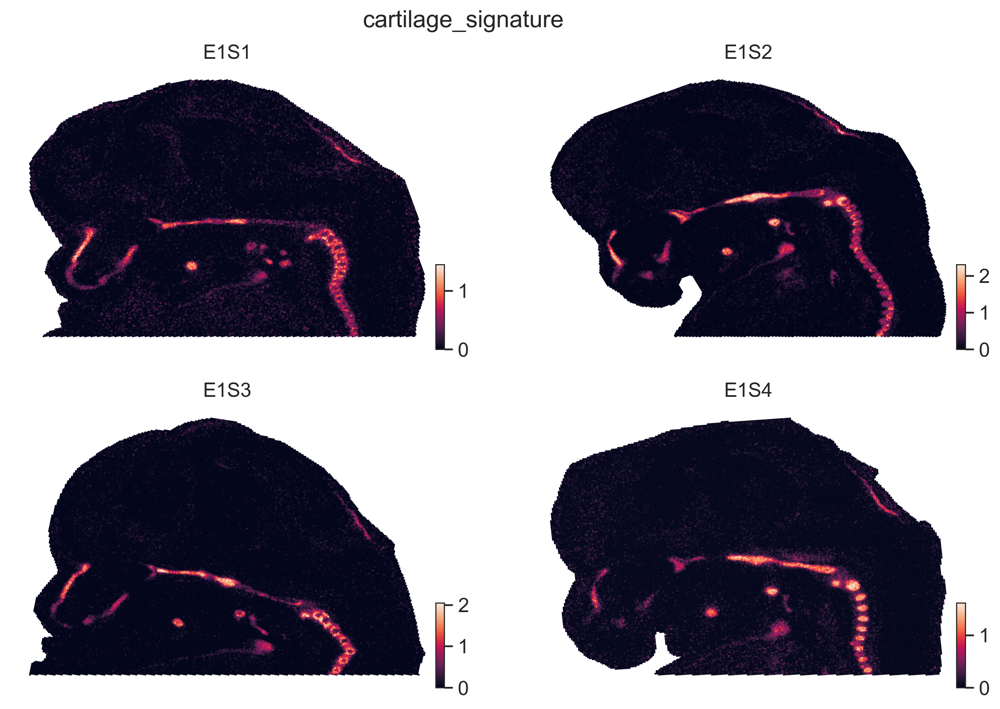

In [112]:
adata.uns["log1p"]["base"] = None

sc.tl.rank_genes_groups(adata, groupby="celltype_l2", groups=["Chondrocyte"])
df = sc.get.rank_genes_groups_df(adata, group="Chondrocyte")
cartilage_genes = list(df[df.logfoldchanges > 4].head(15).names)

calculate_signature(adatas, cartilage_genes, "cartilage_signature")
signature_panel(adatas, score_name="cartilage_signature")

<Axes: title={'center': 'Renamed clonal clusters'}, xlabel='UMAP1', ylabel='UMAP2'>

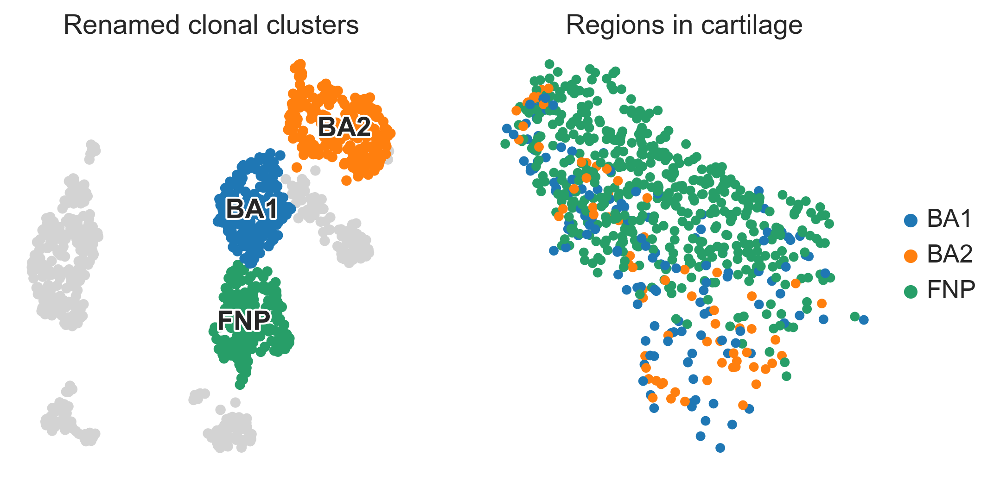

In [491]:
clones.obs["clonal_clusters_regions"] = [
    "BA1" if i == "0" else
    "FNP" if i in ["1", "9"] else
    "BA2" if i in ["4", "2"] else
    "Other" for i in clones.obs.leiden_1
]
adata.obs["clonal_clusters_regions"] = [
    "BA1" if i == "0" else
    "FNP" if i in ["1", "9"] else
    "BA2" if i in ["4", "2"] else
    "Other" for i in adata.obs.clones_clusters_1
]

adata_chondro = adata[
    (adata.obs.celltype_l2 == "Chondrocyte") &
    adata.obs.clonal_clusters_regions.isin(["BA1", "BA2", "FNP"])
]

fig, axes = plt.subplots(ncols=2, figsize=(8, 4))

sc.pl.umap(adata_chondro, color="clonal_clusters_regions", frameon=False, title="Regions in cartilage", ax=axes[1], show=False, s=100)
sc.pl.umap(clones, color="clonal_clusters_regions", frameon=False, title="Renamed clonal clusters", groups=["BA1", "BA2", "FNP"],
           na_in_legend=False, legend_loc="on data", legend_fontoutline=2, ax=axes[0], show=False)

In [570]:
sns.color_palette()

[(0.12156862745098039, 0.4666666666666667, 0.7058823529411765),
 (1.0, 0.4980392156862745, 0.054901960784313725),
 (0.15294117647058825, 0.6196078431372549, 0.40784313725490196),
 (0.8392156862745098, 0.15294117647058825, 0.1568627450980392),
 (0.6666666666666666, 0.25098039215686274, 0.9882352941176471),
 (0.5490196078431373, 0.33725490196078434, 0.29411764705882354),
 (0.8901960784313725, 0.4666666666666667, 0.7607843137254902),
 (0.7098039215686275, 0.7411764705882353, 0.3803921568627451),
 (0.09019607843137255, 0.7450980392156863, 0.8117647058823529),
 (0.6823529411764706, 0.7803921568627451, 0.9098039215686274),
 (1.0, 0.7333333333333333, 0.47058823529411764),
 (0.596078431372549, 0.8745098039215686, 0.5411764705882353),
 (1.0, 0.596078431372549, 0.5882352941176471),
 (0.7725490196078432, 0.6901960784313725, 0.8352941176470589),
 (0.7686274509803922, 0.611764705882353, 0.5803921568627451),
 (0.9686274509803922, 0.7137254901960784, 0.8235294117647058),
 (0.8588235294117647, 0.8588235294117647, 0.5529411764705883),
 (0.6196078431372549, 0.8549019607843137, 0.8980392156862745),
 (0.6784313725490196, 0.28627450980392155, 0.2901960784313726),
 (0.5490196078431373, 0.42745098039215684, 0.19215686274509805)]

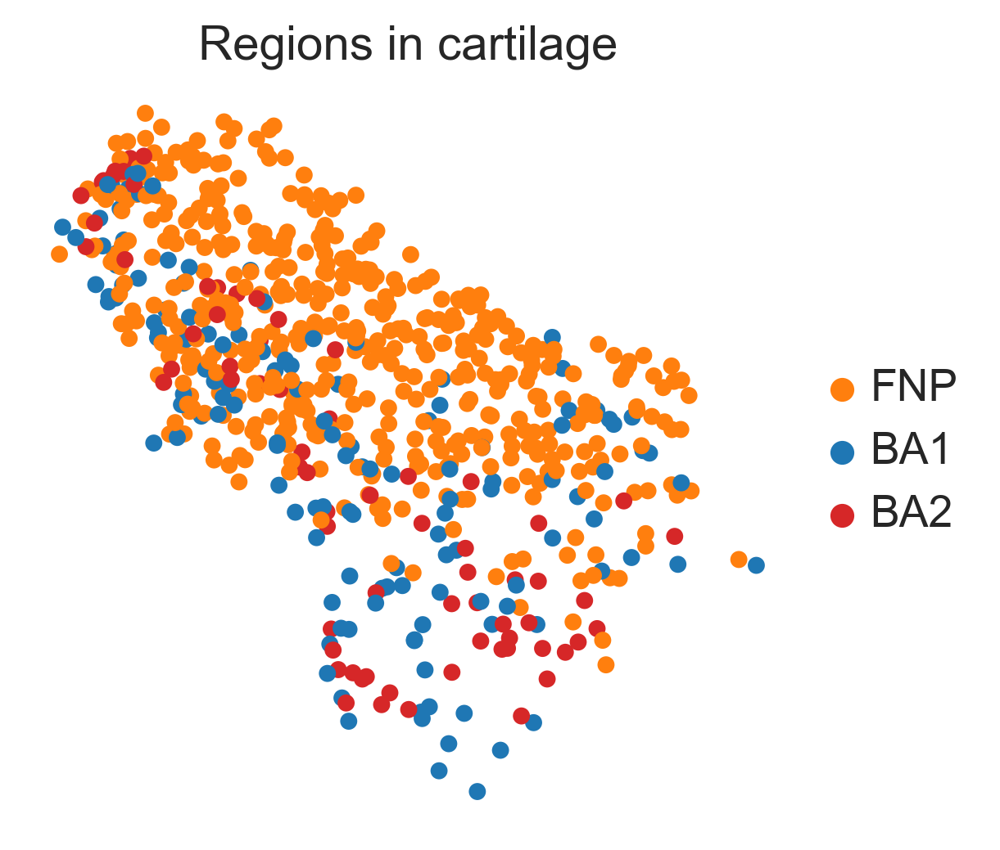

In [573]:
adata_chondro.uns["clonal_clusters_regions_colors"] = [
    sns.color_palette()[1],
    sns.color_palette()[0],
    sns.color_palette()[3],
]

sc.pl.umap(adata_chondro, color="clonal_clusters_regions", frameon=False, title="Regions in cartilage", s=100, save="cartilage_umap_facial.pdf")

In [ ]:
sc.pl.umap(adata_chondro, color="clonal_clusters_regions", frameon=False, title="Regions in cartilage", ax=axes[1], show=False, s=100)

In [380]:
cmap1 = sns.cubehelix_palette(start=0, rot=0, dark=0, light=0.7, reverse=True, as_cmap=True)
cmap2 = sns.cubehelix_palette(start=2, rot=0, dark=0, light=0.7, reverse=True, as_cmap=True)
cmap3 = sns.cubehelix_palette(start=0.6, rot=0, dark=0, light=0.7, reverse=True, as_cmap=True)

In [432]:
# For spatial smoothing

sc.pp.neighbors(adatas[batch], use_rep="X_spatial", n_neighbors=10, key_added="spatial")

In [436]:
gene_FNP = "Alx1"
gene_BA1 = "Asb4"
gene_BA2 = "Hoxa2"

batch = "E1S2"

adatas[batch].obs["cartilage_signature"][adatas[batch].obs["cartilage_signature"] < 0] = 0

adatas[batch].obs["FNP_cartilage"] = adatas[batch][:, gene_FNP].X.A.T[0] * adatas[batch].obs["cartilage_signature"].values
adatas[batch].obs["FNP_cartilage"] = adatas[batch].obs["FNP1_cartilage"] / adatas[batch].obs["FNP1_cartilage"].max()
adatas[batch].obs["FNP_cartilage_smoothed"] = adatas[batch].obs["FNP1_cartilage"] @ adatas[batch].obsp["spatial_connectivities"].A

adatas[batch].obs["BA1_cartilage"] = adatas[batch][:, gene_BA1].X.A.T[0] * adatas[batch].obs["cartilage_signature"].values
adatas[batch].obs["BA1_cartilage"] = adatas[batch].obs["BA1_cartilage"] / adatas[batch].obs["BA1_cartilage"].max()
adatas[batch].obs["BA1_cartilage_smoothed"] = adatas[batch].obs["BA1_cartilage"] @ adatas[batch].obsp["spatial_connectivities"].A

adatas[batch].obs["BA2_cartilage"] = adatas[batch][:, gene_BA2].X.A.T[0] * adatas[batch].obs["cartilage_signature"].values
adatas[batch].obs["BA2_cartilage"] = adatas[batch].obs["BA2_cartilage"] / adatas[batch].obs["BA2_cartilage"].max()
adatas[batch].obs["BA2_cartilage_smoothed"] = adatas[batch].obs["BA2_cartilage"] @ adatas[batch].obsp["spatial_connectivities"].A

argmax = np.argmax(adatas[batch].obs[["FNP_cartilage_smoothed", "BA1_cartilage_smoothed", "BA2_cartilage_smoothed"]].values, axis=1)
adatas[batch].obs["FNP_cartilage_smoothed"][argmax != 0] = 0
adatas[batch].obs["BA1_cartilage_smoothed"][argmax != 1] = 0
adatas[batch].obs["BA2_cartilage_smoothed"][argmax != 2] = 0

adatas[batch].obs["FNP"] = adatas[batch][:, gene_FNP].X.A.T[0] / (adatas[batch][:, gene_FNP].X).max()
adatas[batch].obs["FNP_smoothed"] = adatas[batch].obs["FNP"] @ adatas[batch].obsp["spatial_connectivities"].A

adatas[batch].obs["BA1"] = adatas[batch][:, gene_BA1].X.A.T[0] / (adatas[batch][:, gene_FNP].X).max()
adatas[batch].obs["BA1_smoothed"] = adatas[batch].obs["BA1"] @ adatas[batch].obsp["spatial_connectivities"].A

adatas[batch].obs["BA2"] = adatas[batch][:, gene_BA2].X.A.T[0] / (adatas[batch][:, gene_FNP].X).max()
adatas[batch].obs["BA2_smoothed"] = adatas[batch].obs["BA2"] @ adatas[batch].obsp["spatial_connectivities"].A

argmax = np.argmax(adatas[batch].obs[["FNP_smoothed", "BA1_smoothed", "BA2_smoothed"]].values, axis=1)
adatas[batch].obs["FNP_smoothed"][argmax != 0] = 0
adatas[batch].obs["BA1_smoothed"][argmax != 1] = 0
adatas[batch].obs["BA2_smoothed"][argmax != 2] = 0

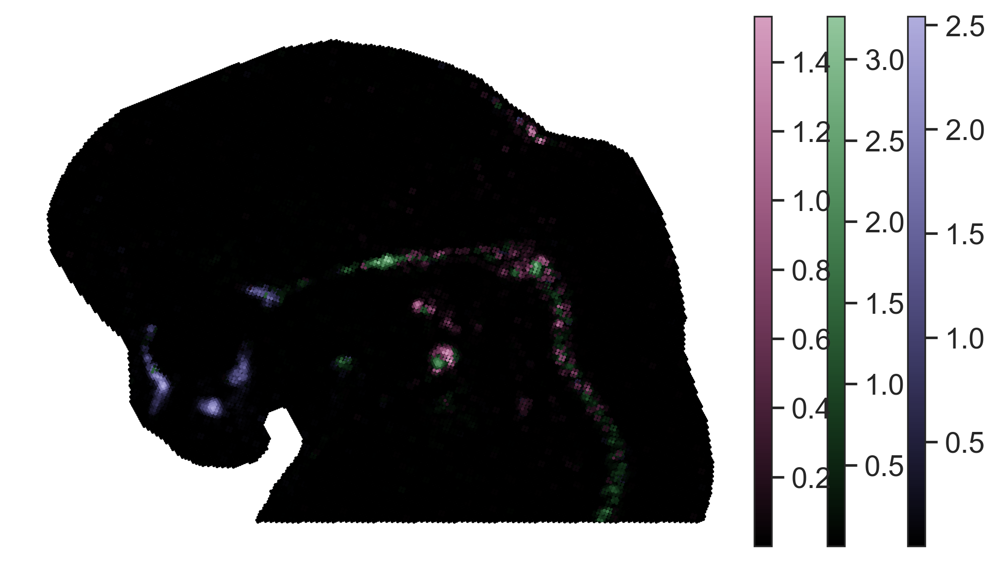

In [466]:
fig, ax = plt.subplots(figsize=(7, 4))

sc.pl.embedding(adatas[batch], basis="X_spatial", ax=ax, show=False, s=10, frameon=False, na_color="black")

sc.pl.embedding(adatas[batch][adatas[batch].obs.FNP_cartilage_smoothed > 0], basis="X_spatial", color="FNP_cartilage_smoothed", ax=ax, show=False, s=10, frameon=False, cmap=cmap1, title="")
sc.pl.embedding(adatas[batch][adatas[batch].obs.BA1_cartilage_smoothed > 0], basis="X_spatial", color="BA1_cartilage_smoothed", ax=ax, show=False, s=10, frameon=False, cmap=cmap2, title="")
sc.pl.embedding(adatas[batch][adatas[batch].obs.BA2_cartilage_smoothed > 0], basis="X_spatial", color="BA2_cartilage_smoothed", ax=ax, show=False, s=10, frameon=False, cmap=cmap3, title="")

fig.tight_layout()

plt.savefig("figures/facial_genes_cartilage_spatial.pdf", bbox_inches="tight")

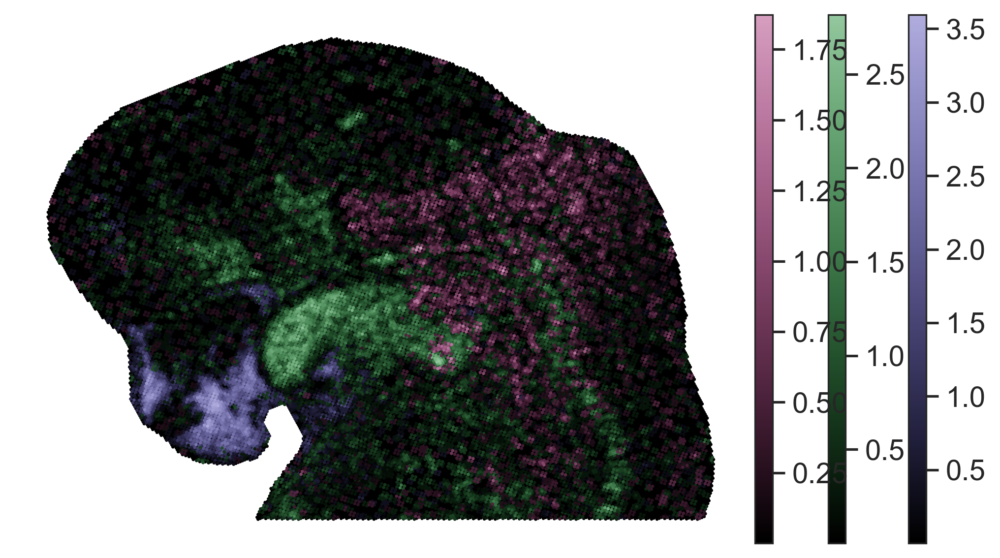

In [464]:
fig, ax = plt.subplots(figsize=(7, 4))

sc.pl.embedding(adatas[batch], basis="X_spatial", ax=ax, show=False, s=10, frameon=False, na_color="black")

sc.pl.embedding(adatas[batch][adatas[batch].obs.FNP_smoothed > 0], basis="X_spatial", color="FNP_smoothed", ax=ax, show=False, s=10, frameon=False, cmap=cmap1, title="")
sc.pl.embedding(adatas[batch][adatas[batch].obs.BA1_smoothed > 0], basis="X_spatial", color="BA1_smoothed", ax=ax, show=False, s=10, frameon=False, cmap=cmap2, title="")
sc.pl.embedding(adatas[batch][adatas[batch].obs.BA2_smoothed > 0], basis="X_spatial", color="BA2_smoothed", ax=ax, show=False, s=10, frameon=False, cmap=cmap3, title="")

fig.tight_layout()

plt.savefig("figures/facial_genes_spatial.pdf", bbox_inches="tight")

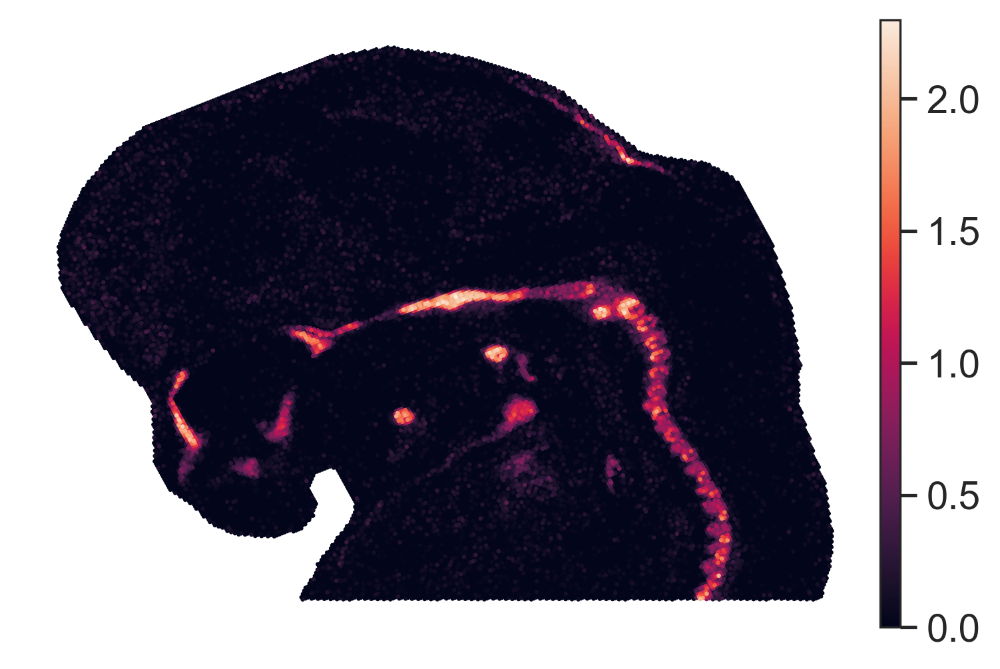

In [465]:
fig, ax = plt.subplots(figsize=(6, 4))

sc.pl.embedding(adatas[batch], basis="X_spatial", color="cartilage_signature", ax=ax, show=False, s=10, frameon=False, title="")

plt.savefig("figures/facial_cartilage_spatial.pdf", bbox_inches="tight")

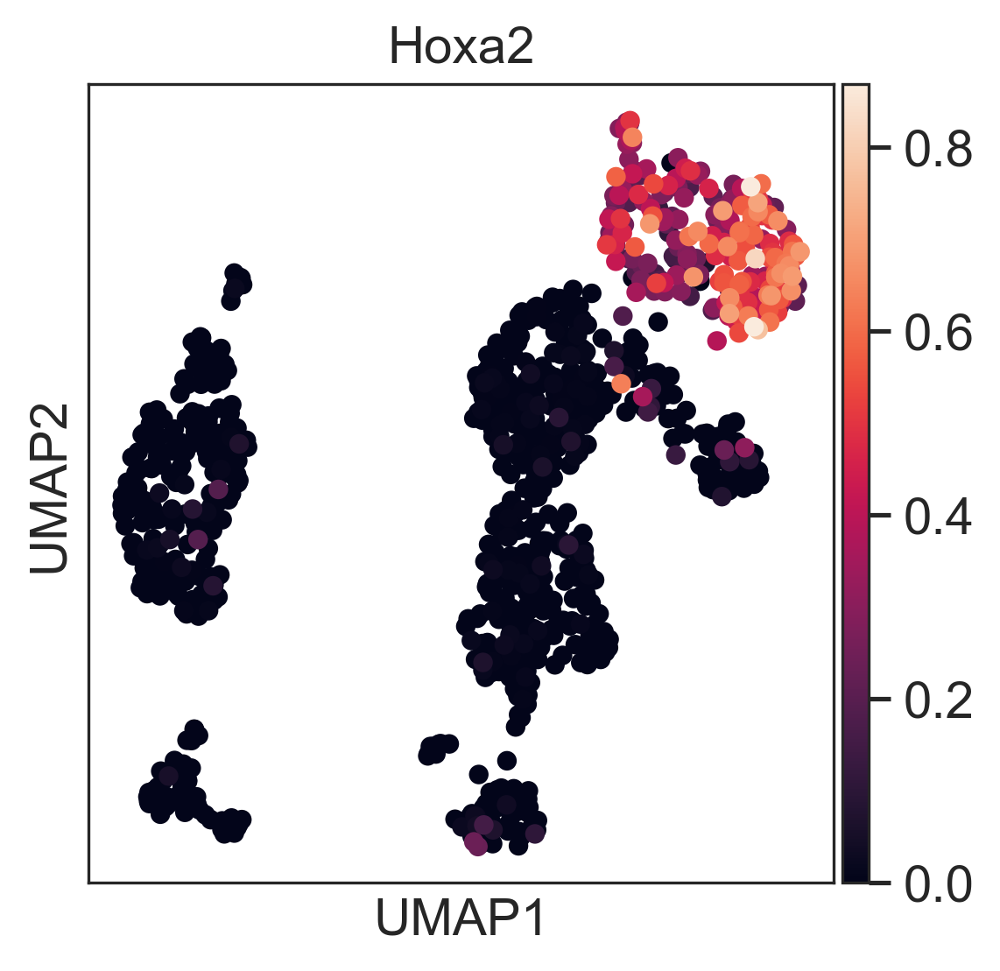

In [ ]:
sc.pl.umap(clones, color="Hoxa2")

In [558]:
adata_chondro.uns["log1p"]["base"] = None

group = "BA1"
reference = "BA2"

sc.tl.rank_genes_groups(adata_chondro, groupby="clonal_clusters_regions", groups=[group], reference=reference)
df = sc.get.rank_genes_groups_df(adata_chondro, group=group)
df[df.logfoldchanges > 2].head(15)

,names,scores,logfoldchanges,pvals,pvals_adj
0,Asb4,7.530655,3.104347,2.225393e-12,5.596640e-08
1,Mkx,7.047227,4.161189,5.651240e-11,7.106152e-07
5,Pdzrn4,6.055133,2.353713,6.706215e-09,2.810910e-05
6,Kazald1,5.793051,2.632908,2.661690e-08,8.367356e-05
9,Dach2,5.660887,2.294745,5.199796e-08,1.452996e-04
12,Col4a1,5.348806,2.295722,2.429773e-07,4.364741e-04
14,Pcp4,5.178471,4.302589,7.329297e-07,1.084262e-03
17,Myl9,5.077201,2.824868,8.792595e-07,1.163816e-03
25,Sparcl1,4.832793,2.616312,2.753215e-06,2.353481e-03
26,Lama2,4.779329,3.046355,3.871925e-06,2.950759e-03


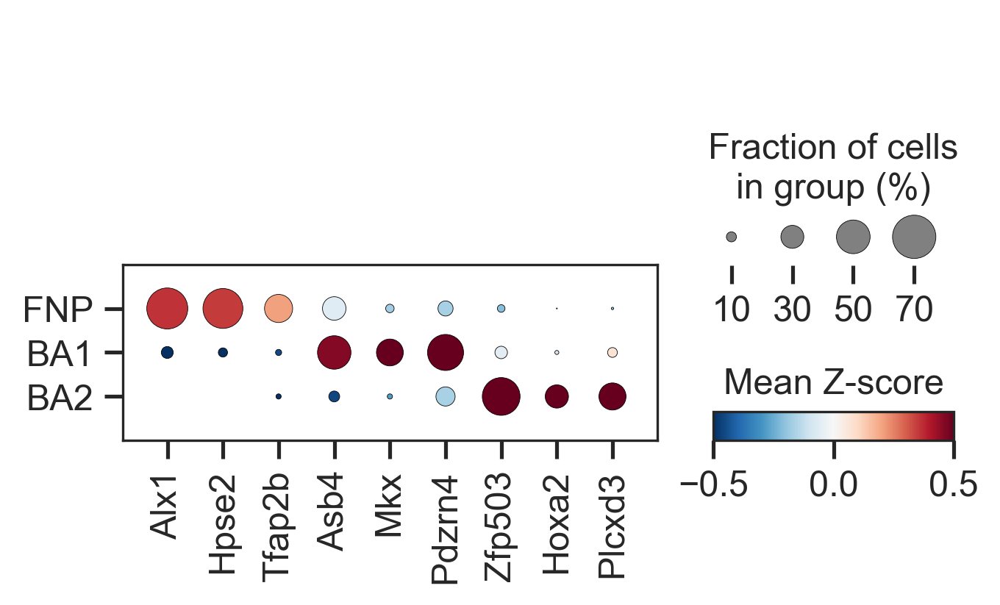

In [564]:
adata_chondro.obs["clonal_clusters_regions"] = adata_chondro.obs["clonal_clusters_regions"].cat.reorder_categories(["FNP", "BA1", "BA2"])

genes = ["Alx1", "Hpse2", "Tfap2b", "Asb4", "Mkx", "Pdzrn4", "Zfp503", "Hoxa2", "Plcxd3"]

adata_plot = adata_chondro[:, genes]
adata_plot.raw = None
sc.pp.scale(adata_plot, max_value=10)

sc.pl.dotplot(adata_plot, groupby="clonal_clusters_regions", var_names=genes, cmap="RdBu_r", vmin=-0.5, vmax=0.5,
              colorbar_title="Mean Z-score", save="regional_genes_in_cartilage.pdf", dot_max=0.7)

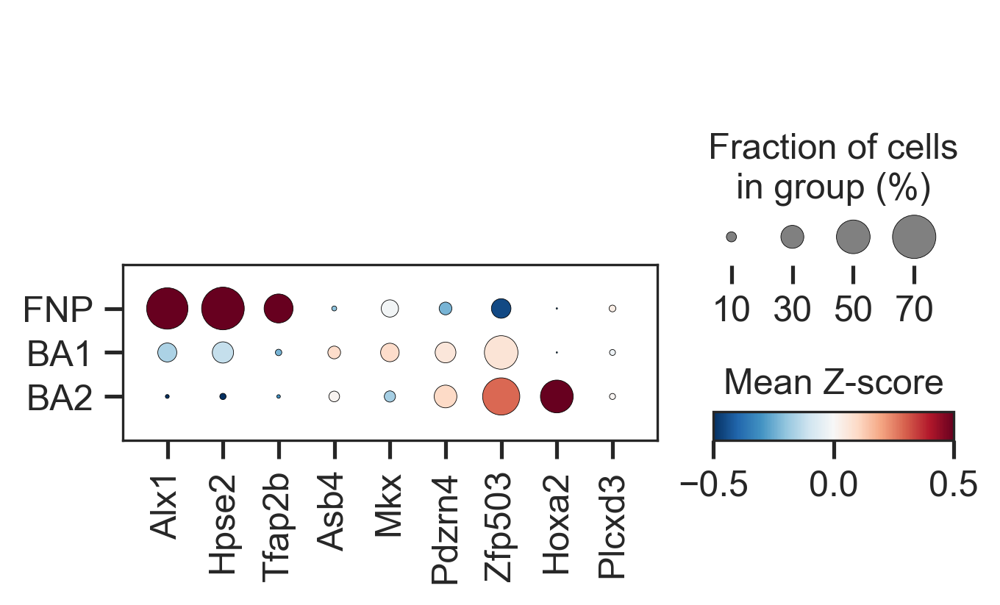

In [565]:
adata_nonchondro = adata[
    (adata.obs.celltype_l2 != "Chondrocyte") &
    adata.obs.clonal_clusters_regions.isin(["BA1", "BA2", "FNP"])
]

adata_nonchondro.obs["clonal_clusters_regions"] = adata_nonchondro.obs["clonal_clusters_regions"].astype("category").cat.reorder_categories(["FNP", "BA1", "BA2"])
genes = ["Alx1", "Hpse2", "Tfap2b", "Asb4", "Mkx", "Pdzrn4", "Zfp503", "Hoxa2", "Plcxd3"]

adata_plot = adata_nonchondro[:, genes]
adata_plot.raw = None
sc.pp.scale(adata_plot, max_value=10)
    
sc.pl.dotplot(adata_plot, groupby="clonal_clusters_regions", var_names=genes, cmap="RdBu_r", vmin=-0.5, vmax=0.5,
              colorbar_title="Mean Z-score", save="regional_genes_in_non_cartilage.pdf", dot_max=0.7)

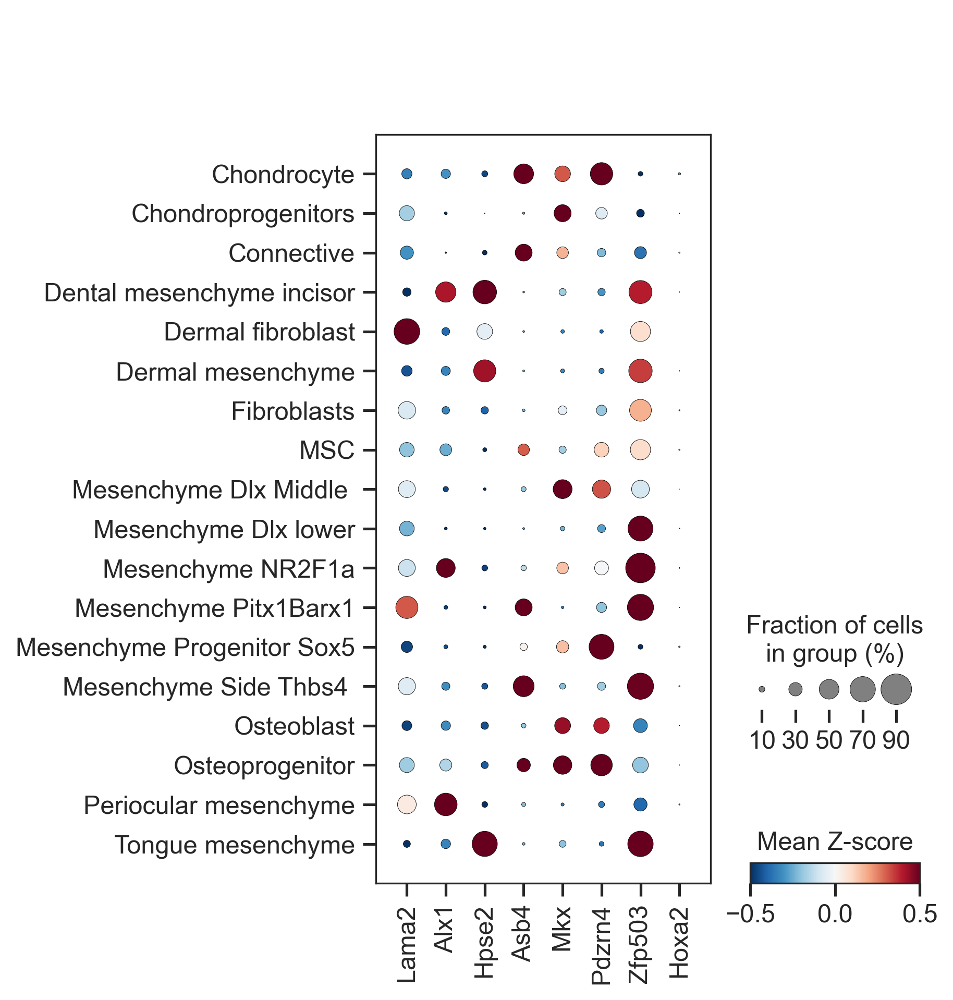

In [539]:
adata_subsection = adata[
    adata.obs.clonal_clusters_regions.isin(["BA1", "BA2", "FNP"])
]

genes = ["Lama2", "Alx1", "Hpse2", "Asb4", "Mkx", "Pdzrn4", "Zfp503", "Hoxa2"]

adata_plot = adata_subsection[:, genes]
adata_plot.raw = None
sc.pp.scale(adata_plot, max_value=10)

adata_plot = adata_plot[adata_plot.obs.clonal_clusters_regions == "BA1"]
adata_plot = adata_plot[adata_plot.obs.celltype_l2.isin(
    adata_plot.obs.celltype_l2.value_counts()[adata_plot.obs.celltype_l2.value_counts() > 100].index
)]

sc.pl.dotplot(adata_plot, groupby="celltype_l2", var_names=genes, cmap="RdBu_r", vmin=-0.5, vmax=0.5, colorbar_title="Mean Z-score", swap_axes=False)

In [ ]:
gene_FNP = "Alx1"
gene_BA1 = "Asb4"
gene_BA2 = "Hoxa2"

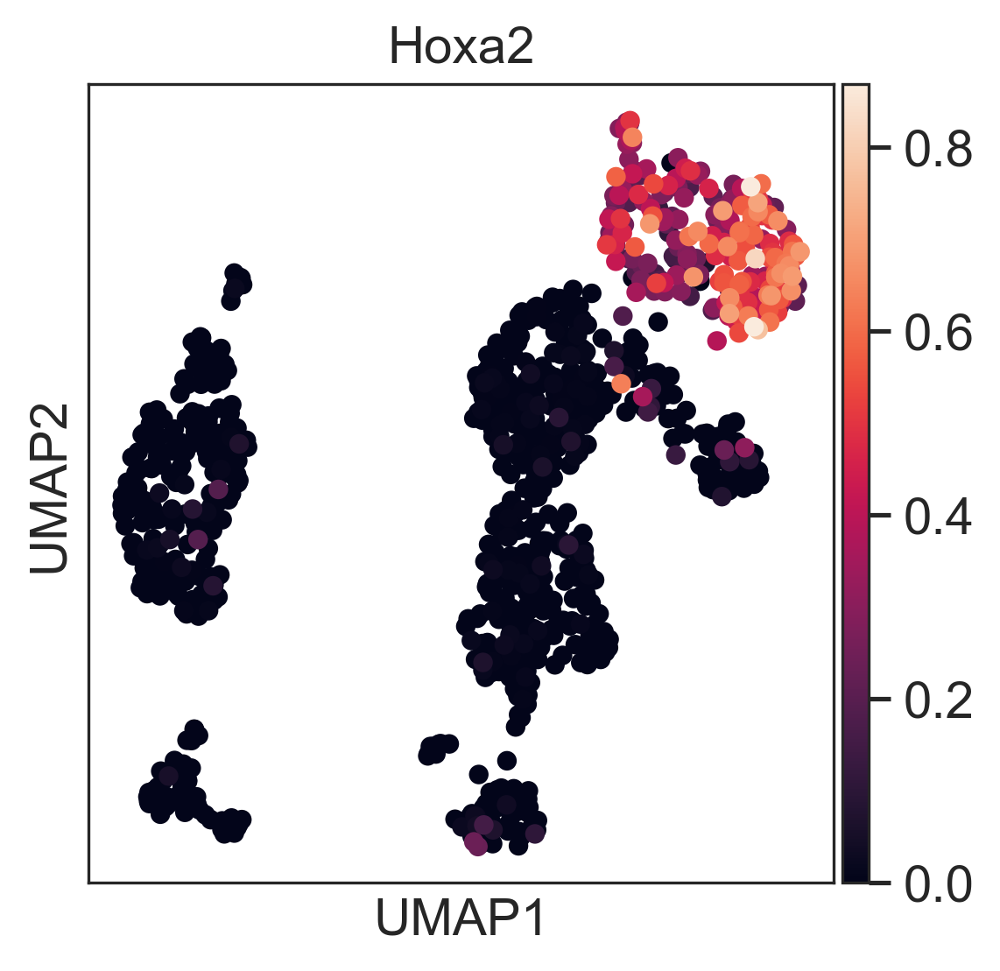

In [ ]:
sc.pl.umap(clones, color="Hoxa2")

In [ ]:
fig, ax = plt.subplots(figsize=(6, 4))

sc.pl.embedding(adatas[batch], basis="X_spatial", color="Pax3", ax=ax, show=False, s=10, frameon=False, title="")

In [ ]:
fig, ax = plt.subplots(figsize=(6, 4))

sc.pl.embedding(adatas[batch], basis="X_spatial", color="Lama2", ax=ax, show=False, s=10, frameon=False, title="")

In [ ]:
gene = "Asb4"

for batch in adatas:
    adatas[batch].obs[f"{gene} * cartilage"] = adatas[batch][:, gene].X.A.T[0] * adatas[batch].obs["cartilage_signature"].values

signature_panel(adatas, score_name=f"{gene} * cartilage")

## Cluster 4

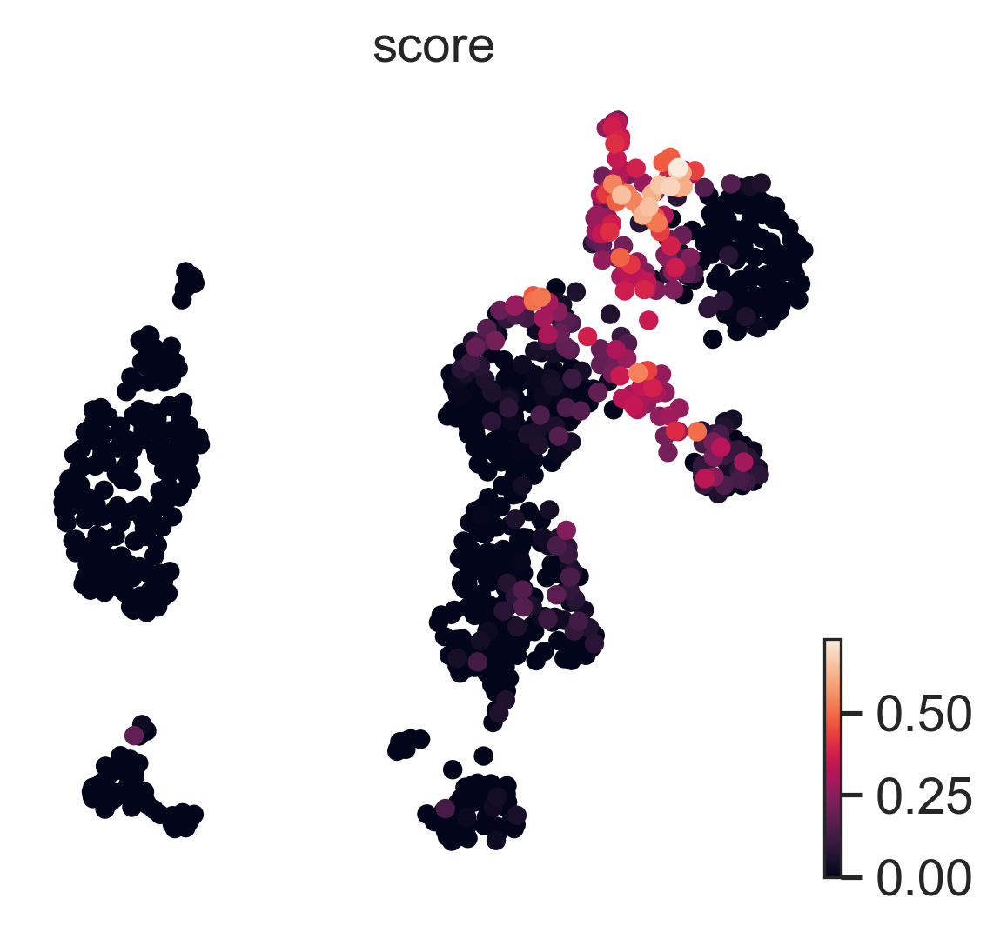

In [ ]:
sc.tl.rank_genes_groups(clones, groupby="leiden_1", groups=["2"], reference="4", method="t-test")
df = sc.get.rank_genes_groups_df(clones, group="2")
signature = list(df[df.logfoldchanges < -2].names[-10:])

sc.tl.score_genes(clones, gene_list=signature)
scv.pl.umap(clones, color="score", vmin=0, frameon=False)

In [ ]:
calculate_signature(adatas, signature=signature, signature_name="cluster_4")
signature_panel(adatas, score_name="cluster_4")

In [ ]:
signatures["cluster_4"] = signature.copy()

## Clusters 2 + 4

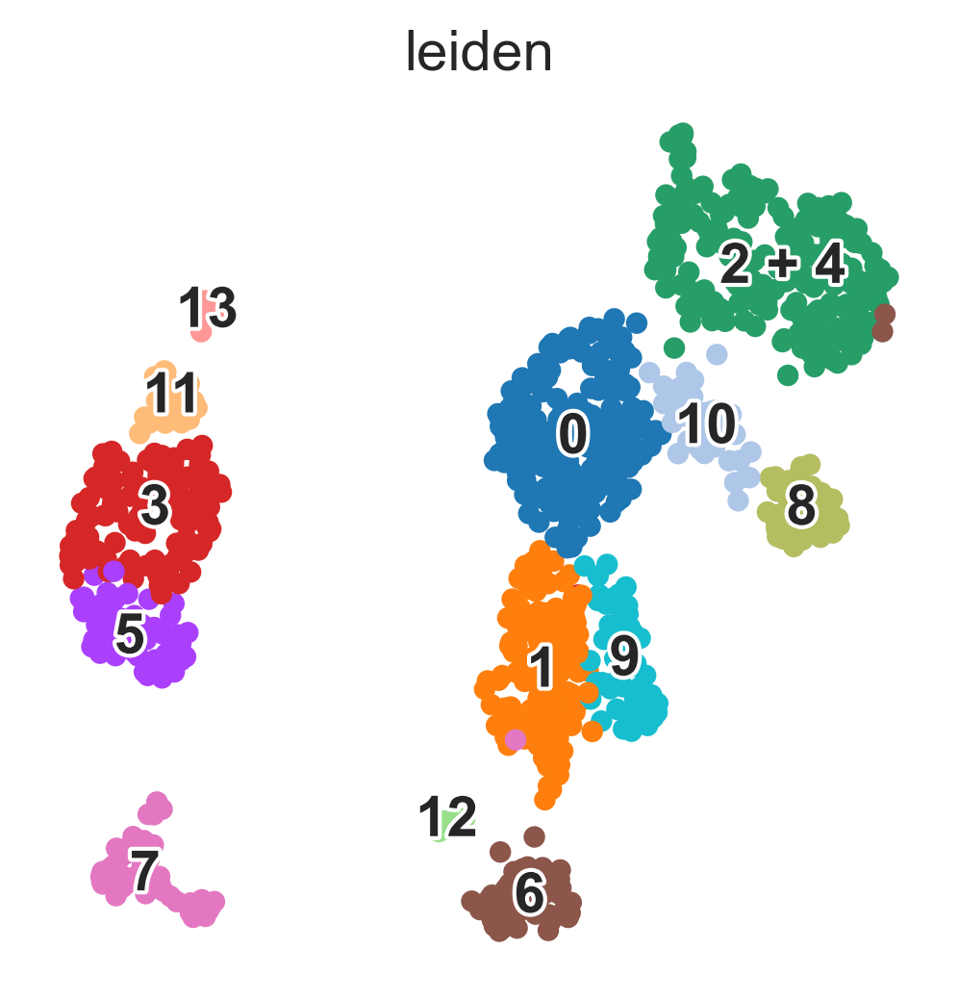

In [ ]:
clones.obs["leiden"] = ["2 + 4" if leiden in ["2", "4"] else leiden for leiden in clones.obs["leiden_1"]]
sc.pl.umap(clones, color="leiden", frameon=False, legend_loc="on data", legend_fontoutline=2)

<Axes: title={'center': '2 + 4 clonal cluster'}>

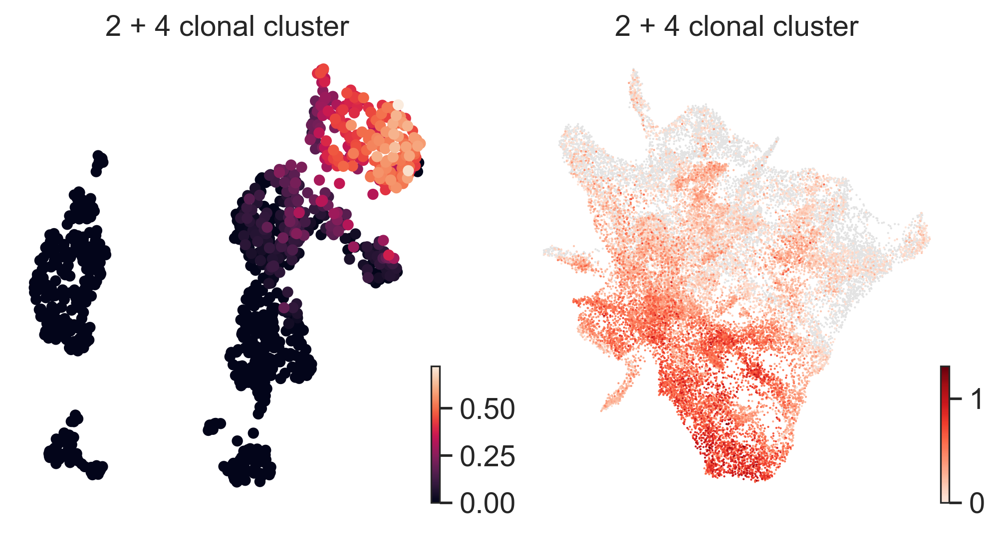

In [ ]:
cluster = "2 + 4"

sc.tl.rank_genes_groups(clones, groupby="leiden", method="t-test")
df = sc.get.rank_genes_groups_df(clones, group=cluster)
signature = list(df[df.logfoldchanges > 2].names[:20])

fig, axes = plt.subplots(ncols=2, figsize=(8, 4))

sc.tl.score_genes(clones, gene_list=signature)
scv.pl.umap(clones, color="score", vmin=0, frameon=False, ax=axes[0], show=False, title=f"{cluster} clonal cluster")

sc.tl.score_genes(adata, gene_list=signature)
scv.pl.umap(adata, color="score", vmin=0, frameon=False, ax=axes[1], show=False, title=f"{cluster} clonal cluster",  cmap=mb.pl.beautiful_cmap())

In [ ]:
calculate_signature(adatas, signature=signature, signature_name=f"{cluster} clonal cluster")
signature_panel(adatas, score_name=f"{cluster} clonal cluster")

## Cluster 0

<Axes: title={'center': '0 clonal cluster'}>

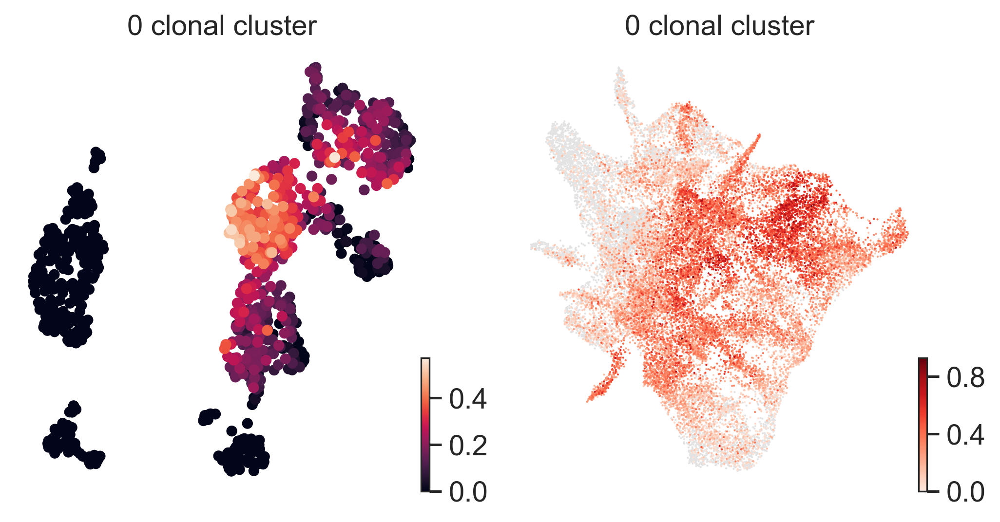

In [211]:
cluster = "0"

sc.tl.rank_genes_groups(clones, groupby="leiden", method="t-test")
df = sc.get.rank_genes_groups_df(clones, group=cluster)
signature = list(df[df.logfoldchanges > 1.7].names[:20])

fig, axes = plt.subplots(ncols=2, figsize=(8, 4))

sc.tl.score_genes(clones, gene_list=signature)
scv.pl.umap(clones, color="score", vmin=0, frameon=False, ax=axes[0], show=False, title=f"{cluster} clonal cluster")

sc.tl.score_genes(adata, gene_list=signature)
scv.pl.umap(adata, color="score", vmin=0, frameon=False, ax=axes[1], show=False, title=f"{cluster} clonal cluster",  cmap=mb.pl.beautiful_cmap())

In [ ]:
calculate_signature(adatas, signature=signature, signature_name=f"{cluster} clonal cluster")
signature_panel(adatas, score_name=f"{cluster} clonal cluster")

## Cluster 1

<Axes: title={'center': '1 clonal cluster'}>

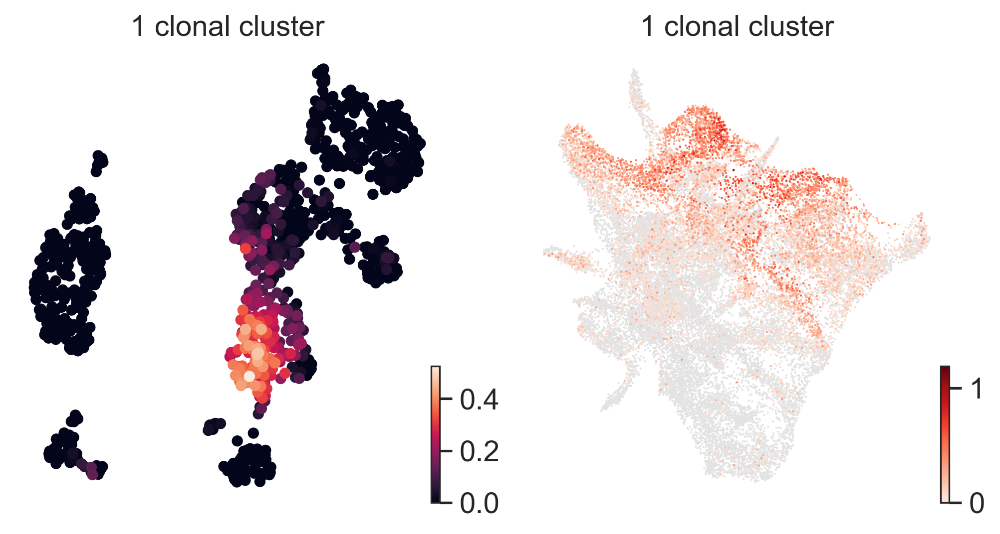

In [208]:
cluster = "1"

sc.tl.rank_genes_groups(clones, groupby="leiden", method="t-test")
df = sc.get.rank_genes_groups_df(clones, group=cluster)
signature = list(df[df.logfoldchanges > 1.7].names[:20])

fig, axes = plt.subplots(ncols=2, figsize=(8, 4))

sc.tl.score_genes(clones, gene_list=signature)
scv.pl.umap(clones, color="score", vmin=0, frameon=False, ax=axes[0], show=False, title=f"{cluster} clonal cluster")

sc.tl.score_genes(adata, gene_list=signature)
scv.pl.umap(adata, color="score", vmin=0, frameon=False, ax=axes[1], show=False, title=f"{cluster} clonal cluster", cmap=mb.pl.beautiful_cmap())

In [ ]:
calculate_signature(adatas, signature=signature, signature_name=f"{cluster} clonal cluster")
signature_panel(adatas, score_name=f"{cluster} clonal cluster")

## Cluster 9

<Axes: title={'center': '9 clonal cluster'}>

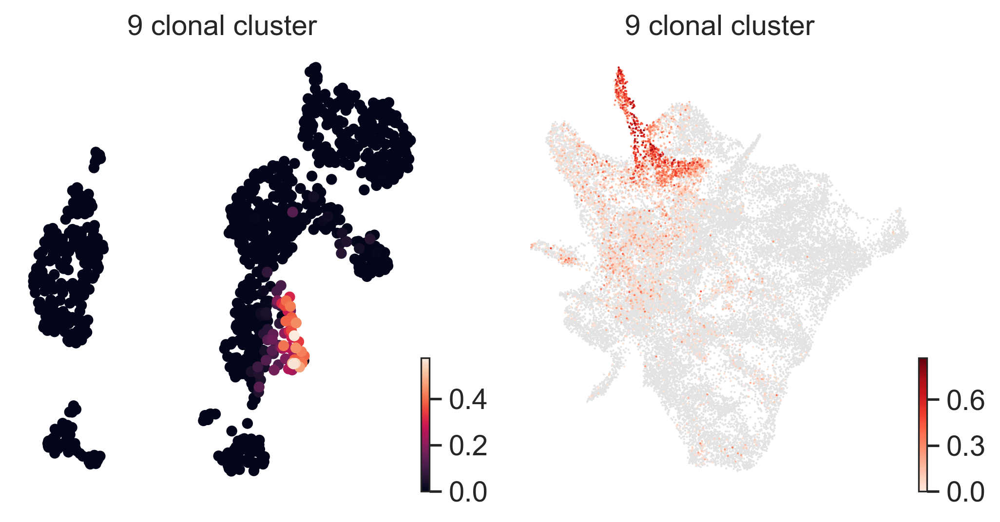

In [210]:
cluster = "9"

sc.tl.rank_genes_groups(clones, groupby="leiden", method="t-test")
df = sc.get.rank_genes_groups_df(clones, group=cluster)
signature = list(df[df.logfoldchanges > 2].names[:20])

fig, axes = plt.subplots(ncols=2, figsize=(8, 4))

sc.tl.score_genes(clones, gene_list=signature)
scv.pl.umap(clones, color="score", vmin=0, frameon=False, ax=axes[0], show=False, title=f"{cluster} clonal cluster")

sc.tl.score_genes(adata, gene_list=signature)
scv.pl.umap(adata, color="score", vmin=0, frameon=False, ax=axes[1], show=False, title=f"{cluster} clonal cluster",  cmap=mb.pl.beautiful_cmap())

In [ ]:
calculate_signature(adatas, signature=signature, signature_name=f"{cluster} clonal cluster")
signature_panel(adatas, score_name=f"{cluster} clonal cluster")

# Neuronal clonal clusters

In [215]:
adata_n = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_face_E13/face_neur_E13_clonal_clusters.h5ad")

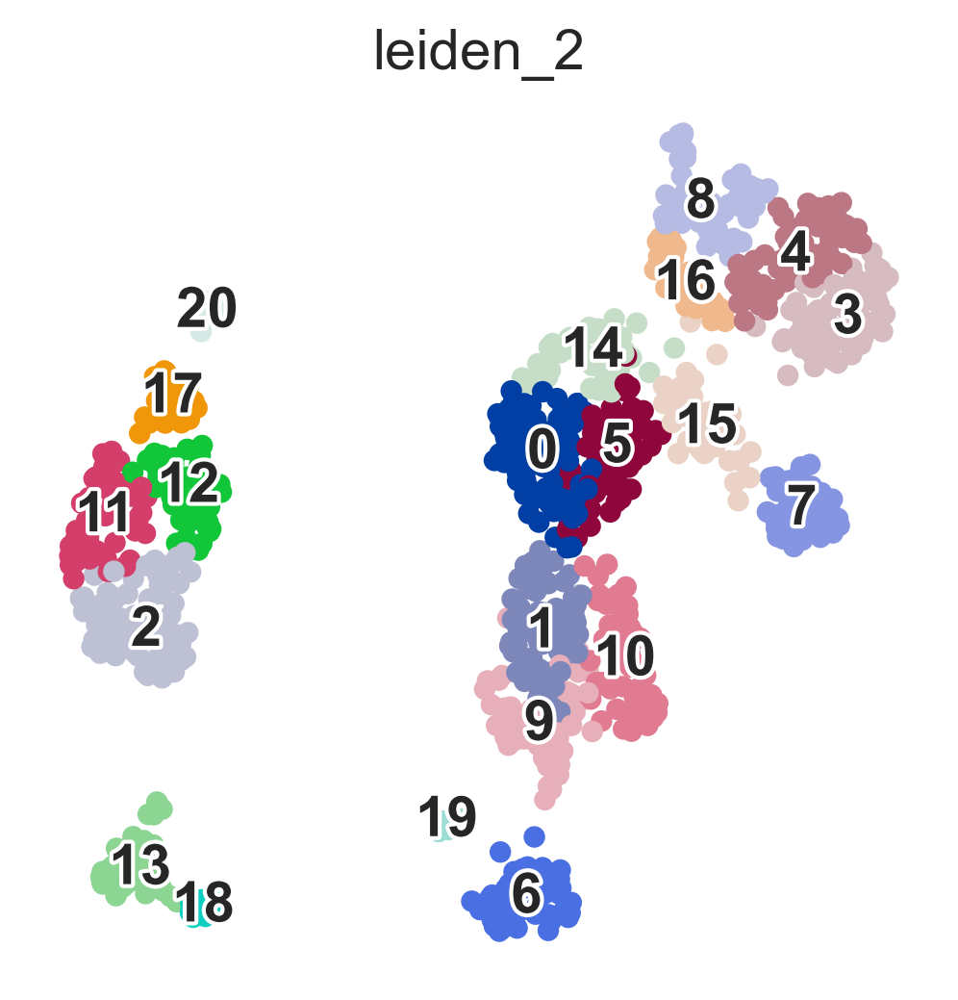

In [238]:
sc.pl.umap(clones, color="leiden_2", frameon=False, legend_loc="on data", legend_fontoutline=2)

## Cluster 11

<Axes: title={'center': '11 clonal cluster'}>

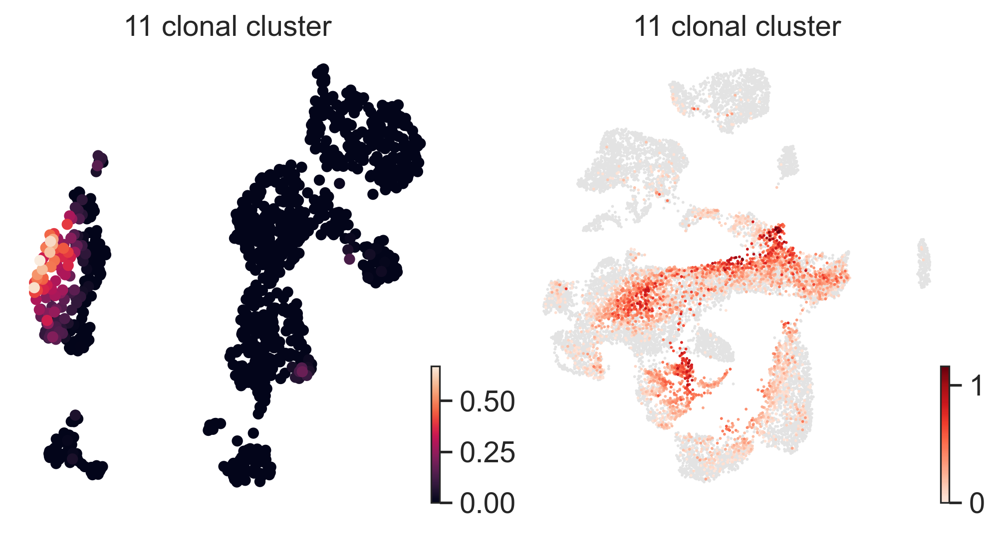

In [230]:
cluster = "11"

sc.tl.rank_genes_groups(clones, groupby="leiden_2", groups=["11"], reference="12", method="t-test")
df = sc.get.rank_genes_groups_df(clones, group="11")
signature = list(df[df.logfoldchanges > 2].names[:20])

fig, axes = plt.subplots(ncols=2, figsize=(8, 4))

sc.tl.score_genes(clones, gene_list=signature)
scv.pl.umap(clones, color="score", vmin=0, frameon=False, ax=axes[0], show=False, title=f"{cluster} clonal cluster")

sc.tl.score_genes(adata_n, gene_list=signature)
scv.pl.umap(adata_n, color="score", vmin=0, frameon=False, ax=axes[1], show=False, title=f"{cluster} clonal cluster",  cmap=mb.pl.beautiful_cmap())

In [ ]:
calculate_signature(adatas, signature=signature, signature_name=f"{cluster} clonal cluster")
signature_panel(adatas, score_name=f"{cluster} clonal cluster")

## Cluster 12

In [246]:
clones_subset = clones[clones.obs.leiden_2.isin(["11", "12", "2", "17"])]
sc.tl.rank_genes_groups(clones_subset, groupby="leiden_2", method="t-test")

<Axes: title={'center': '12 clonal cluster'}>

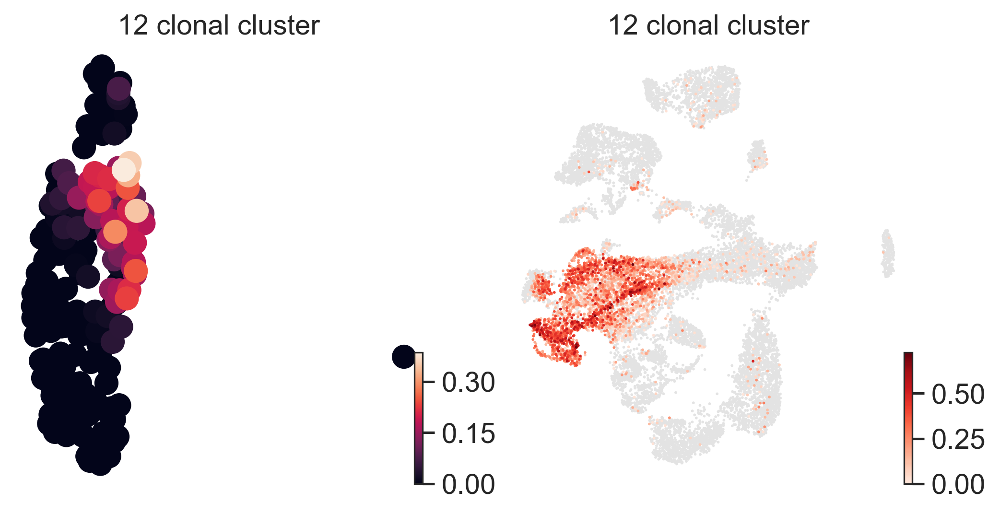

In [248]:
cluster = "12"

df = sc.get.rank_genes_groups_df(clones_subset, group=cluster)
signature = list(df[df.logfoldchanges > 2].names[:20])

fig, axes = plt.subplots(ncols=2, figsize=(8, 4))

sc.tl.score_genes(clones_subset, gene_list=signature)
scv.pl.umap(clones_subset, color="score", vmin=0, frameon=False, ax=axes[0], show=False, title=f"{cluster} clonal cluster")

sc.tl.score_genes(adata_n, gene_list=signature)
scv.pl.umap(adata_n, color="score", vmin=0, frameon=False, ax=axes[1], show=False, title=f"{cluster} clonal cluster",  cmap=mb.pl.beautiful_cmap())

In [ ]:
calculate_signature(adatas, signature=signature, signature_name=f"{cluster} clonal cluster")
signature_panel(adatas, score_name=f"{cluster} clonal cluster")

## Cluster 2

<Axes: title={'center': '2 clonal cluster'}>

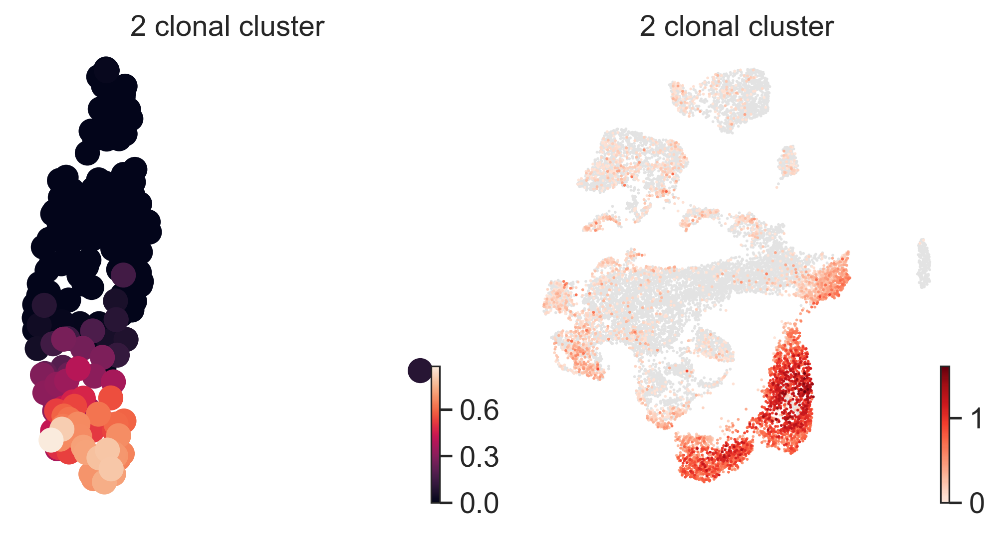

In [250]:
cluster = "2"

df = sc.get.rank_genes_groups_df(clones_subset, group=cluster)
signature = list(df[df.logfoldchanges > 2].names[:20])

fig, axes = plt.subplots(ncols=2, figsize=(8, 4))

sc.tl.score_genes(clones_subset, gene_list=signature)
scv.pl.umap(clones_subset, color="score", vmin=0, frameon=False, ax=axes[0], show=False, title=f"{cluster} clonal cluster")

sc.tl.score_genes(adata_n, gene_list=signature)
scv.pl.umap(adata_n, color="score", vmin=0, frameon=False, ax=axes[1], show=False, title=f"{cluster} clonal cluster",  cmap=mb.pl.beautiful_cmap())

In [ ]:
calculate_signature(adatas, signature=signature, signature_name=f"{cluster} clonal cluster")
signature_panel(adatas, score_name=f"{cluster} clonal cluster")

## Cluster 17

<Axes: title={'center': '17 clonal cluster'}>

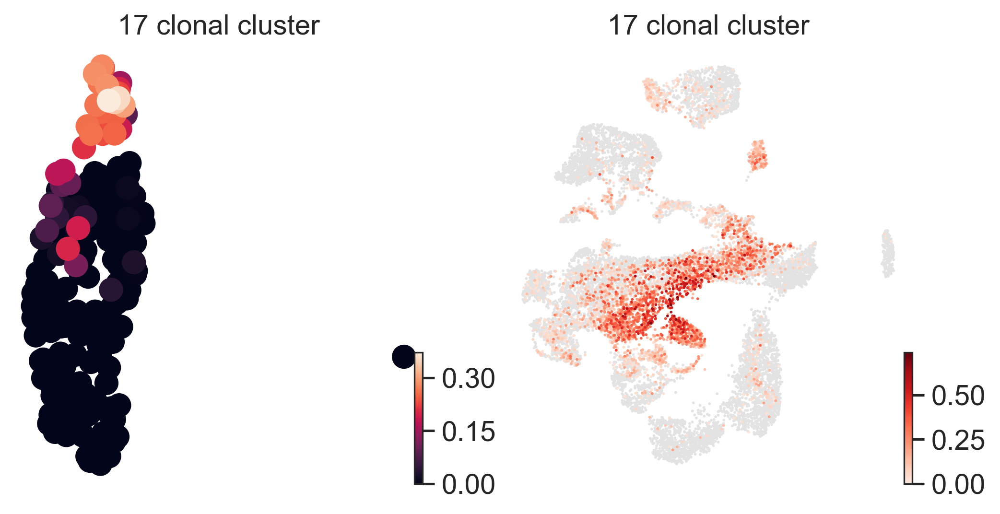

In [252]:
cluster = "17"

df = sc.get.rank_genes_groups_df(clones_subset, group=cluster)
signature = list(df[df.logfoldchanges > 2].names[:20])

fig, axes = plt.subplots(ncols=2, figsize=(8, 4))

sc.tl.score_genes(clones_subset, gene_list=signature)
scv.pl.umap(clones_subset, color="score", vmin=0, frameon=False, ax=axes[0], show=False, title=f"{cluster} clonal cluster")

sc.tl.score_genes(adata_n, gene_list=signature)
scv.pl.umap(adata_n, color="score", vmin=0, frameon=False, ax=axes[1], show=False, title=f"{cluster} clonal cluster",  cmap=mb.pl.beautiful_cmap())

In [ ]:
calculate_signature(adatas, signature=signature, signature_name=f"{cluster} clonal cluster")
signature_panel(adatas, score_name=f"{cluster} clonal cluster")

# Whole embryo

In [467]:
adatas_whole = {}

In [468]:
adata_ = sc.read_h5ad("/home/sergey/data/mouse_spatial/E13/E13.5_E1S1.MOSTA.h5ad")
adata_.obsm["spatial"] = flip_vertically(adata_.obsm["spatial"])
clear_adata(adata_)
adatas_whole["E1S1"] = adata_.copy()

In [469]:
adata_ = sc.read_h5ad("/home/sergey/data/mouse_spatial/E13/E13.5_E1S2.MOSTA.h5ad")
adata_.obsm["spatial"] = flip_vertically(adata_.obsm["spatial"])
clear_adata(adata_)
adatas_whole["E1S2"] = adata_.copy()

In [470]:
adata_ = sc.read_h5ad("/home/sergey/data/mouse_spatial/E13/E13.5_E1S3.MOSTA.h5ad")
adata_.obsm["spatial"] = flip_vertically(adata_.obsm["spatial"])
clear_adata(adata_)
adatas_whole["E1S3"] = adata_.copy()

In [471]:
adata_ = sc.read_h5ad("/home/sergey/data/mouse_spatial/E13/E13.5_E1S4.MOSTA.h5ad")
adata_.obsm["spatial"] = flip_vertically(adata_.obsm["spatial"])
clear_adata(adata_)
adatas_whole["E1S4"] = adata_.copy()

In [ ]:
signature_panel(adatas_whole, score_name="Ednrb", height=16)

In [ ]:
signature = ["Zeb2", "Gucy1a1", "Tcf21", "Ppp1r14a", "Gucy1b1", "Foxf1", "Ednrb", "Hoxb5", "Wnt2", "Car2"]
cell_type = "Duct mesenchyme"

calculate_signature(adatas_whole, signature=signature, signature_name=f"{cell_type} signature")
signature_panel(adatas_whole, score_name=f"{cell_type} signature", height=16)

In [ ]:
signature = ["Tmem132c", "Twist2", "Irx3", "Cxcl14", "Irx5", "Bcl11b", "Apcdd1", "Mybpc1", "Irx1", "Lix1"]
cell_type = "Dermal mesenchyme"

calculate_signature(adatas_whole, signature=signature, signature_name=f"{cell_type} signature")
signature_panel(adatas_whole, score_name=f"{cell_type} signature", height=16)

In [ ]:
signature = ["Anxa2", "Dcn", "Celf2", "Cdon", "Osr1", "Tbx15", "S100a10", "Gxylt2", "Dkk2", "Igf1", "Agtr2", "Lox", "Tmeff2", "Tmem26", "Erc2", "Cxcl14", "Fgf7"]
cell_type = "Dermal fibroblasts"

calculate_signature(adatas_whole, signature=signature, signature_name=f"{cell_type} signature")
signature_panel(adatas_whole, score_name=f"{cell_type} signature", height=16)

In [ ]:
signature = ["Pax1", "Rnf220", "Smoc1", "Bhlhe41", "Vwa2", "Artn", "Gm49890", "Krt15", "Tnfrsf11a", "A530006G24Rik"]
cell_type = "IVD"

calculate_signature(adatas_whole, signature=signature, signature_name=f"{cell_type} signature")
signature_panel(adatas_whole, score_name=f"{cell_type} signature", height=16)

In [ ]:
signature = ["Dner", "Gpm6a", "Igfbpl1", "Mir124-2hg", "Rmst", "Grin2b", "Pid1", "Ntrk2",
             "Gm17750", "Myo16", "Gm3764", "Egfem1", "Nxph1", "Marchf1", "Vav3", "Lamp5",
             "Mir9-3hg", "ENSMUSG00000120008", "Elmod1", "Zic1"]
cell_type = "Mistery"

calculate_signature(adatas_whole, signature=signature, signature_name=f"{cell_type} signature")
signature_panel(adatas_whole, score_name=f"{cell_type} signature", height=16)

In [ ]:
signature_panel(adatas_whole, score_name=f"Ihh", height=16)

In [ ]:
signature_panel(adatas_whole, score_name=f"Shh", height=16)

# Cartilage within clonal clusters

In [473]:
clones = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_trunk_E13/E13_clonal_embedding.h5ad")

adata = sc.read_h5ad("/home/sergey/data/clonal_project/anndatas/merged_clones_trunk_E13/trunk_mes_E13_clonal_clusters.h5ad")
adata.uns["log1p"]["base"] = None

In [474]:
sc.tl.rank_genes_groups(adata, groupby="celltype_l2", group="Chondroblasts")

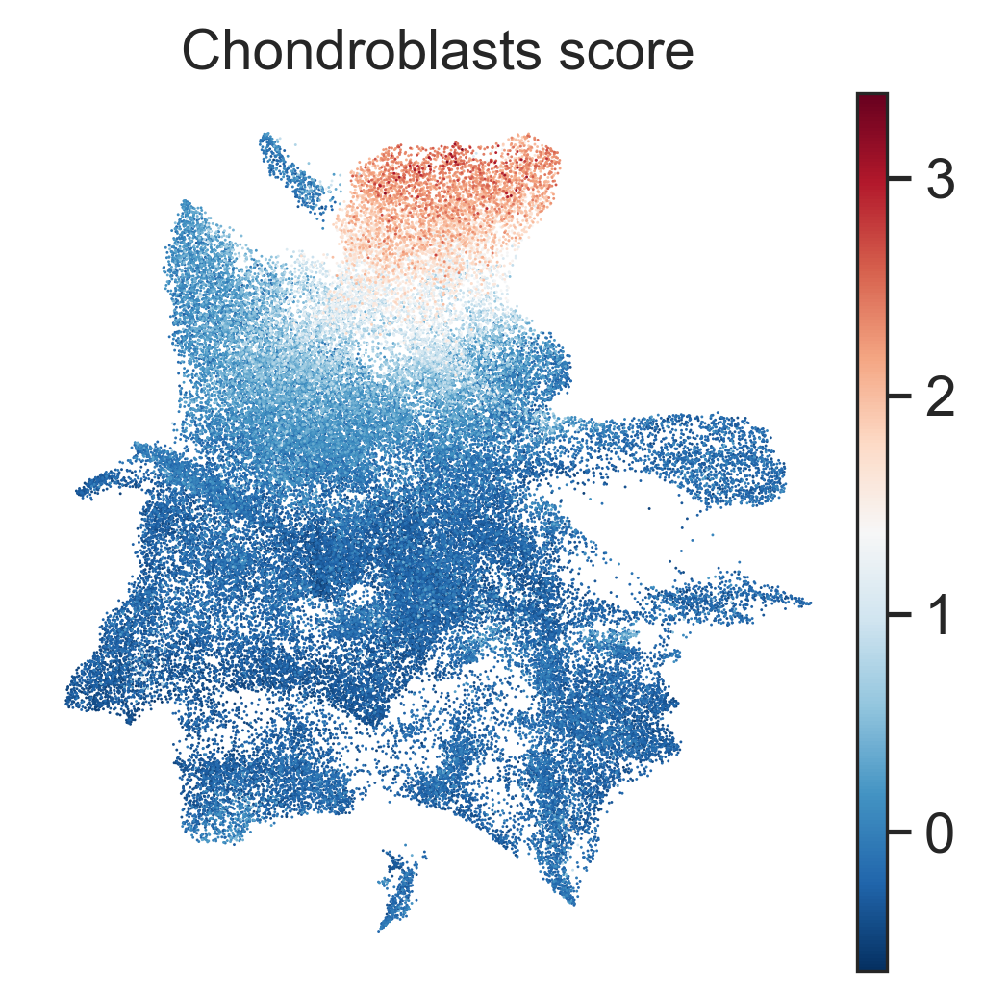

In [475]:
num_genes = 20
max_fdr = 1e-10
min_logfc = 3

df = sc.get.rank_genes_groups_df(adata, group="Chondroblasts")
chondro_signature = df[
    (df.logfoldchanges > min_logfc) &
    (df.pvals_adj < max_fdr)
].names[:num_genes]

sc.tl.score_genes(adata, gene_list=chondro_signature, score_name="Chondroblasts_score")
sc.pl.umap(adata, color="Chondroblasts_score", frameon=False, cmap="RdBu_r", title="Chondroblasts score")

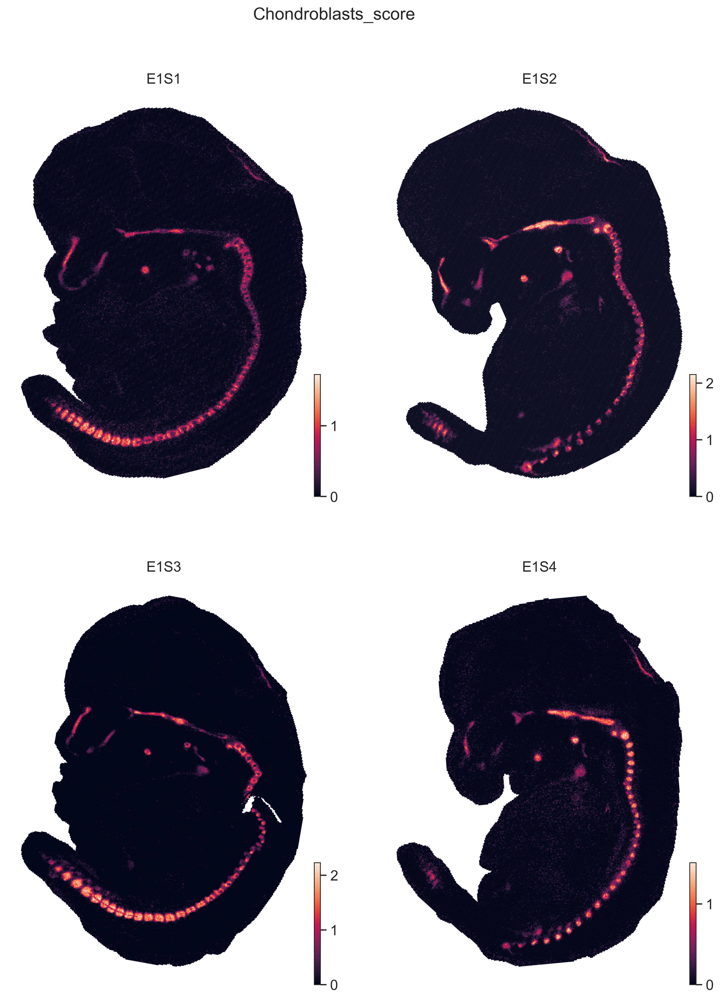

In [476]:
calculate_signature(adatas_whole, signature=chondro_signature, signature_name="Chondroblasts_score")
signature_panel(adatas_whole, score_name="Chondroblasts_score", height=16, vmin=0)

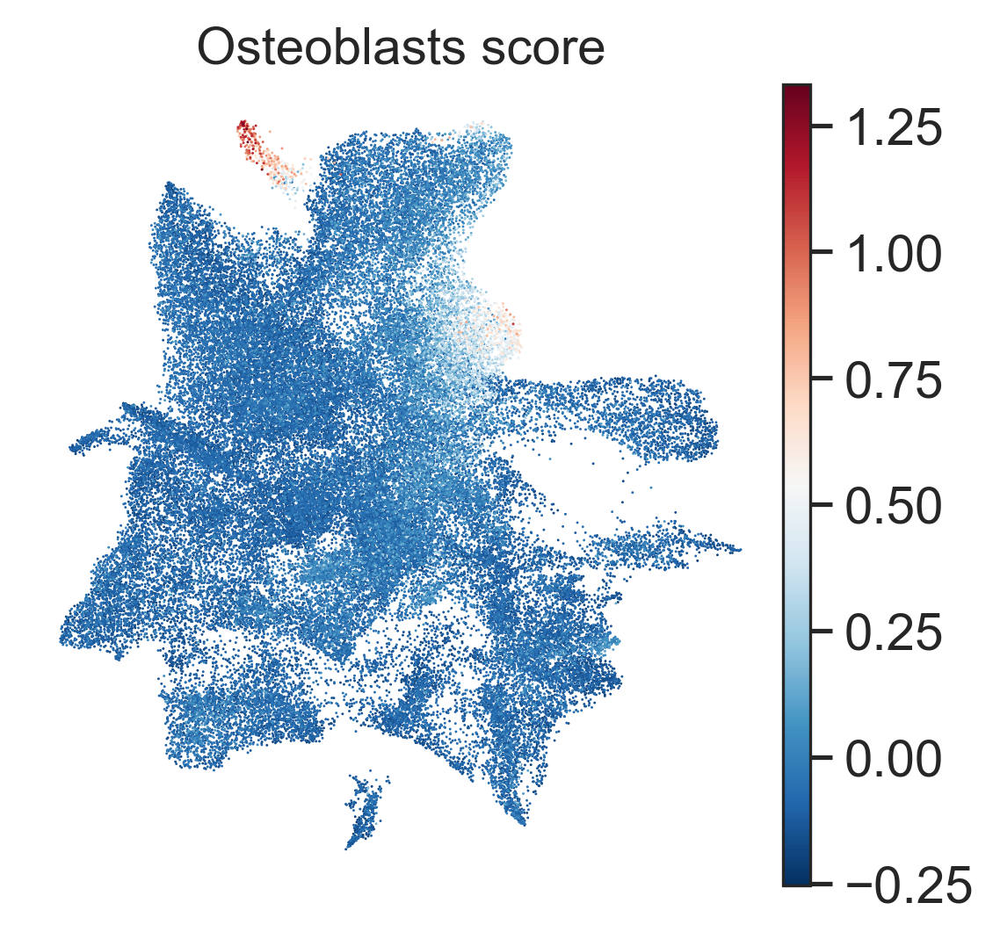

In [108]:
sc.tl.rank_genes_groups(adata, groupby="celltype_l2", group="Osteoblasts")

num_genes = 20
max_fdr = 1e-10
min_logfc = 3

df = sc.get.rank_genes_groups_df(adata, group="Osteoblasts")
osteo_signature = df[
    (df.logfoldchanges > min_logfc) &
    (df.pvals_adj < max_fdr)
].names[:num_genes]

sc.tl.score_genes(adata, gene_list=osteo_signature, score_name="Osteoblasts_score")
sc.pl.umap(adata, color="Osteoblasts_score", frameon=False, cmap="RdBu_r", title="Osteoblasts score")

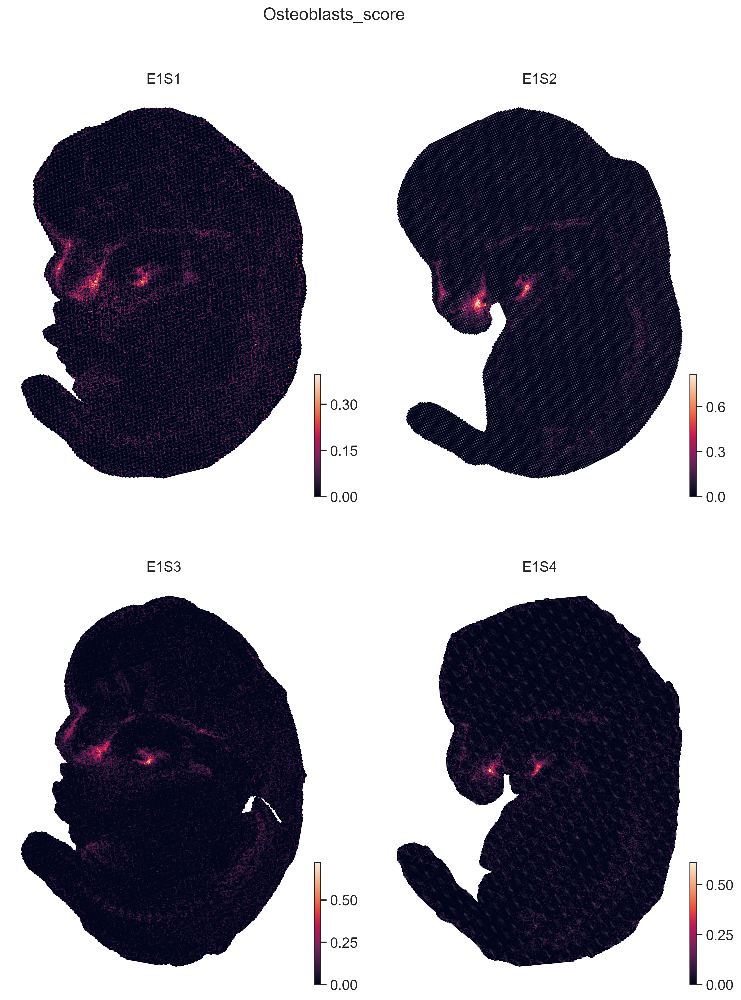

In [109]:
calculate_signature(adatas_whole, signature=osteo_signature, signature_name="Osteoblasts_score")
signature_panel(adatas_whole, score_name="Osteoblasts_score", height=16, vmin=0)

In [478]:
adata_chondro = adata[adata.obs.celltype_l2 == "Chondroblasts"].copy()
sc.tl.rank_genes_groups(adata_chondro, groupby="clones_clusters_1")

In [483]:
n_genes = 30
max_fdr = 1e-5
min_logfc = 1.5

clonal_signature = {}

for target in ["2", "8"]:
    df = sc.get.rank_genes_groups_df(adata_chondro, group=target)
    clonal_signature[target] = df[
        (df.logfoldchanges > min_logfc) &
        (df.pvals_adj < max_fdr)
    ].names[:num_genes]
    
    sc.tl.score_genes(adata, gene_list=clonal_signature[target], score_name=f"Clonal_cluster_{target}_signature")
    adata.obs[f"Clonal_cluster_{target}_signature_Chondro"] = np.minimum(
        adata.obs[f"Clonal_cluster_{target}_signature"],
        adata.obs.Chondroblasts_score,
    )
    
    calculate_signature(adatas_whole, signature=clonal_signature[target], signature_name=f"Clonal_cluster_{target}_signature")
    for batch in adatas_whole:
        adatas_whole[batch].obs[f"Clonal_cluster_{target}_signature_Chondro"] = np.minimum(
            adatas_whole[batch].obs[f"Clonal_cluster_{target}_signature"],
            adatas_whole[batch].obs.Chondroblasts_score,
        )

In [ ]:
signature_panel(adatas_whole, score_name="Clonal_cluster_8_signature_Chondro", height=16, vmin=0, vmax=0.5, s=8)

In [ ]:
signature_panel(adatas_whole, score_name="Clonal_cluster_2_signature_Chondro", height=16, vmin=0, vmax=0.5, s=8)

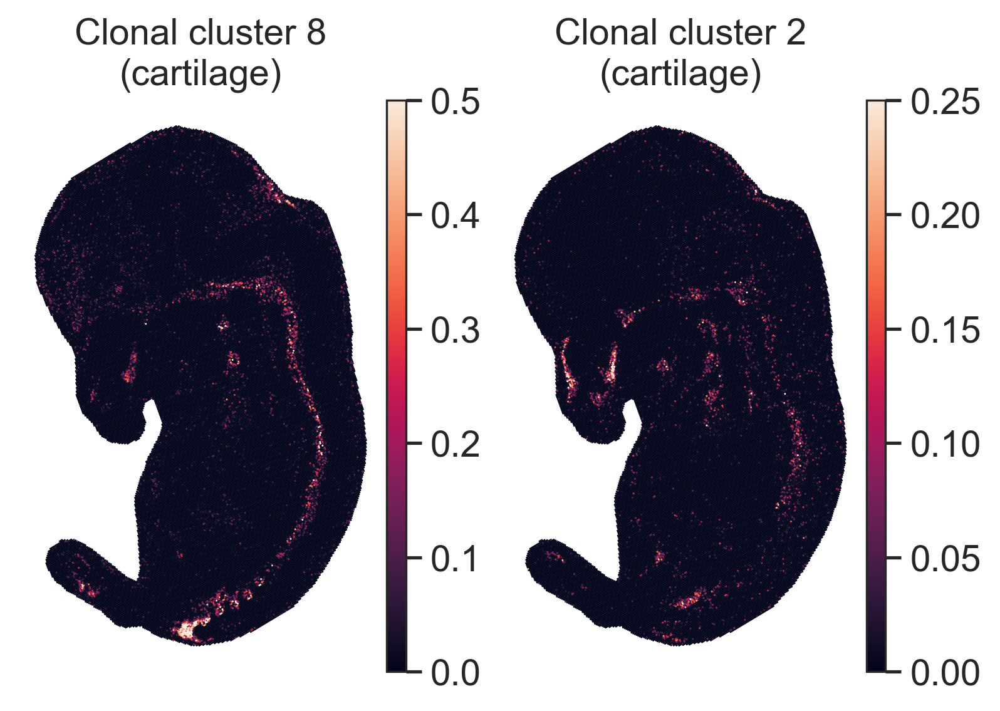

In [204]:
fig, axes = plt.subplots(ncols=2, figsize=(6, 4))

sc.pl.embedding(
    adatas_whole["E1S2"],
    basis="spatial",
    color="Clonal_cluster_8_signature_Chondro",
    ax=axes[0],
    show=False,
    s=2,
    vmin=0,
    vmax=0.5,
    frameon=False,
    title="Clonal cluster 8\n(cartilage)"
)

sc.pl.embedding(
    adatas_whole["E1S2"],
    basis="spatial",
    color="Clonal_cluster_2_signature_Chondro",
    ax=axes[1],
    show=False,
    s=2,
    vmin=0,
    vmax=0.25,
    frameon=False,
    title="Clonal cluster 2\n(cartilage)"
)

plt.savefig(f"../figures/fig3/spatial.pdf", bbox_inches="tight")

In [ ]:
signature_panel(adatas_whole, score_name="Clonal_cluster_2_signature_Chondro", height=16, vmin=0, vmax=0.25, s=8)

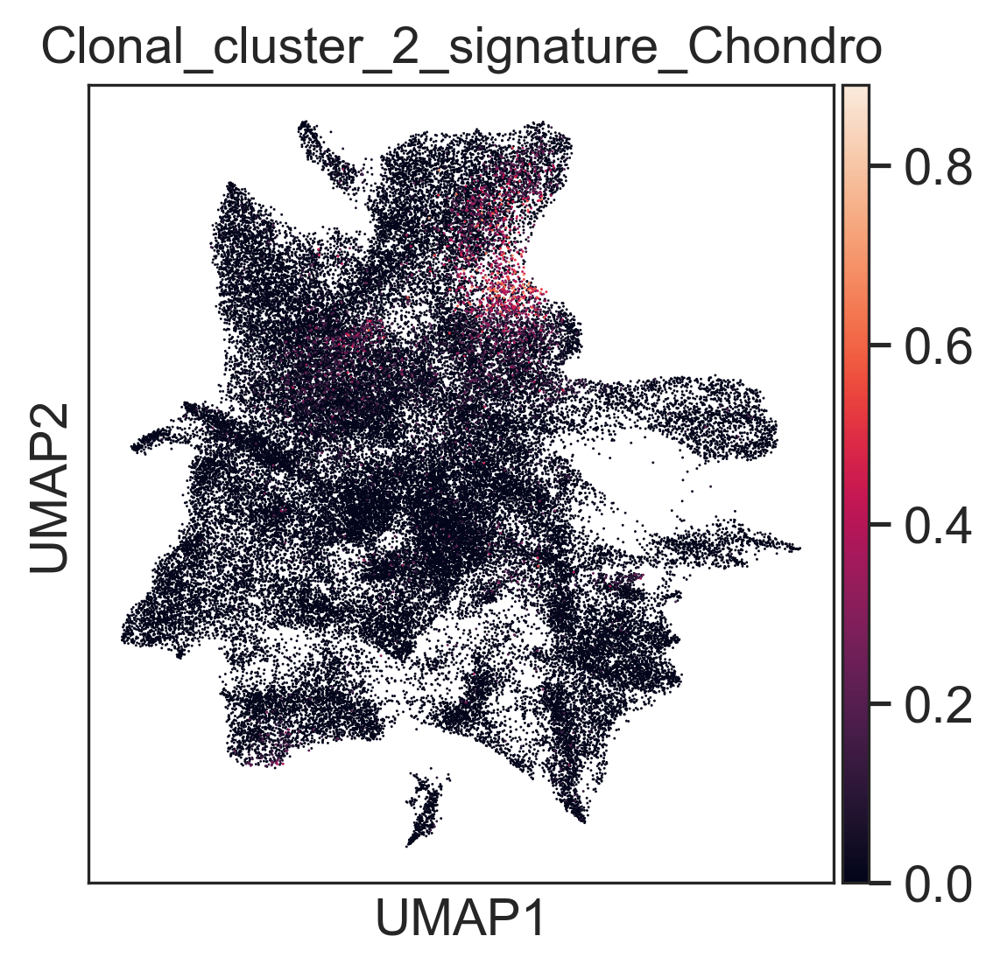

In [122]:
sc.pl.umap(adata, color="Clonal_cluster_2_signature_Chondro", vmin=0)

In [ ]:
signature_panel(adatas_whole, score_name="Clonal_cluster_2_signature_Chondro", height=16, vmin=0, vmax=0.3)

In [ ]:
sc.pl.embedding(adata, basis="spatial", color=["Hoxb5"], s=10)